# Lab 2: Homography estimation and applications

In this lab you will learn how to estimate a homography relating two images given a set of correspondences between them. Then, you will work with different computer vision applications of the homography.

More precisely, the goals are:

1) Homography estimation with the DLT algorithm. <br>

2) Application: Image mosaics. <br>

3) Refinement of the estimated homography with the Gold Standard algorithm. <br>

4) Application: Camera calibration with a planar pattern and augmented reality. <br>

5) Application: Logo detection. <br>

6) Application: Logo replacement.

The following file combines some text cells (Markdown cells) and code cells. Some parts of the code need to be completed. All tasks you need to complete are marked in <span style='color:Green'> green.  </span>

In [1]:
import numpy as np
import cv2
import math
import sys
import matplotlib
from matplotlib import pyplot as plt
from operator import itemgetter
from utils import apply_H_fixed_image_size, plot_img, Ransac_DLT_homography
import random

np.random.seed(42)
random.seed(42)
cv2.setRNGSeed(42)

## **1. Homography estimation with the DLT algorithm**

### **1.1 Compute image correspondences**
Execute the following code to find image correspondences using ORB [1] (you may also use SIFT, SURF, etc)

[1] Ethan Rublee, Vincent Rabaud, Kurt Konolige, Gary R. Bradski: ORB: An efficient alternative to SIFT or SURF. ICCV 2011: 2564-2571.

#### ORB 

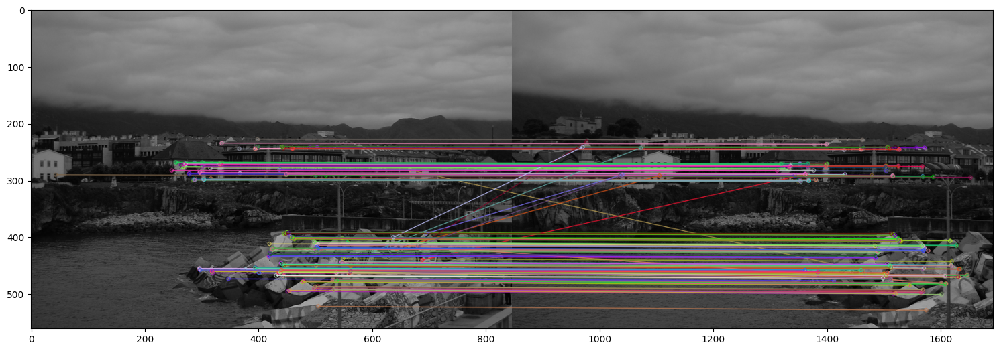

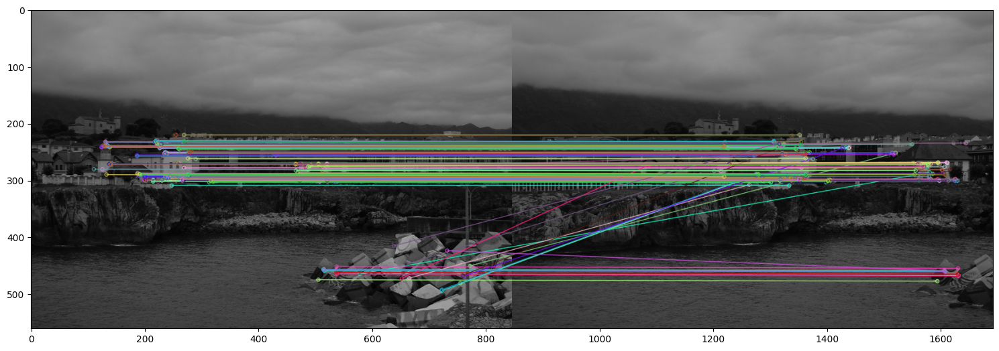

In [2]:
# Read images
img1 = cv2.imread('Data/llanes/llanes_a.jpg',cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/llanes/llanes_b.jpg',cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/llanes/llanes_c.jpg',cv2.IMREAD_GRAYSCALE)

# Initiate ORB detector
orb = cv2.ORB_create()
# find the keypoints and descriptors with ORB
kp1_orb, des1_orb = orb.detectAndCompute(img1,None)
kp2_orb, des2_orb = orb.detectAndCompute(img2,None)
kp3_orb, des3_orb = orb.detectAndCompute(img3,None)

# Keypoint matching
bf = cv2.BFMatcher(cv2.NORM_HAMMING) # Hamming distance for ORB 
orb_matches_12 = bf.knnMatch(des1_orb,des2_orb,k=2)
# Apply ratio test
orb_good_matches_12 = []
for m,n in orb_matches_12:
    # The ratio threshold can be decreased to be more selective (fewer, cleaner matches).
    # However, if it is too strict, most remaining matches are already inliers, so the
    # benefit of the RANSAC-based homography estimation becomes less noticeable in the plots.
    if m.distance < 0.85*n.distance: 
        orb_good_matches_12.append([m])

orb_matches_23 = bf.knnMatch(des2_orb,des3_orb,k=2)
# Apply ratio test
orb_good_matches_23 = []
for m,n in orb_matches_23:
    if m.distance < 0.85*n.distance: 
        orb_good_matches_23.append([m])


# Show "good" matches 
img_12 = cv2.drawMatchesKnn(img1,kp1_orb,img2,kp2_orb,orb_good_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_12)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

img_23 = cv2.drawMatchesKnn(img2,kp2_orb,img3,kp3_orb,orb_good_matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_23)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

#### SIFT

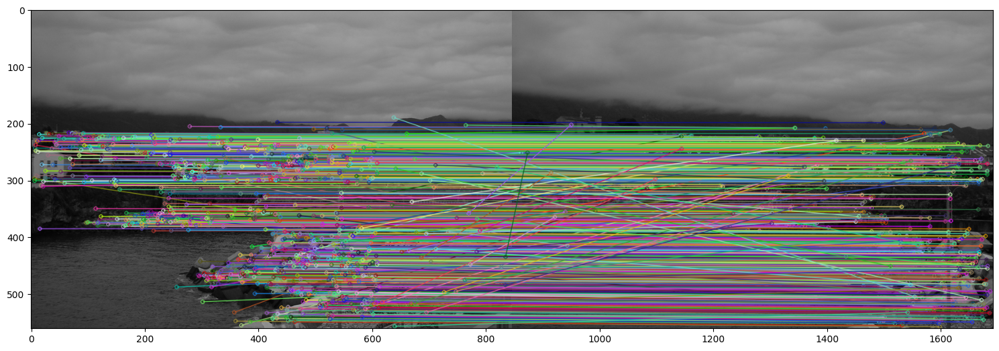

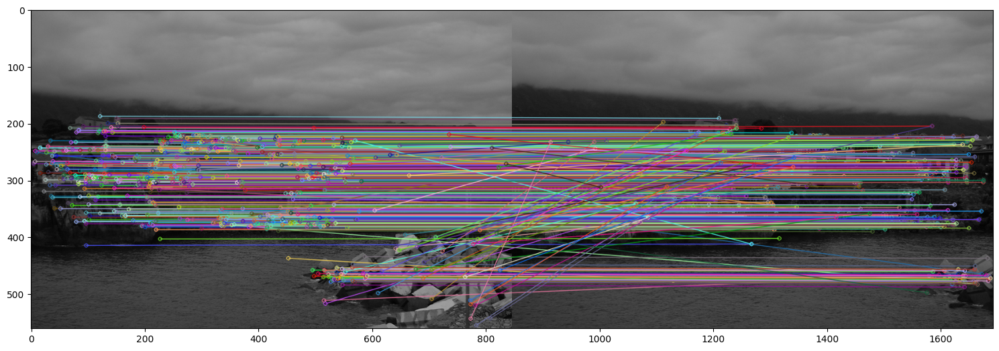

In [3]:
# Read images
img1 = cv2.imread('Data/llanes/llanes_a.jpg',cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/llanes/llanes_b.jpg',cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/llanes/llanes_c.jpg',cv2.IMREAD_GRAYSCALE)

# Initiate SIFT detector
sift = cv2.SIFT_create()
# find the keypoints and descriptors with SIFT
kp1_sift, des1_sift = sift.detectAndCompute(img1,None)
kp2_sift, des2_sift = sift.detectAndCompute(img2,None)
kp3_sift, des3_sift = sift.detectAndCompute(img3,None)

# Keypoint matching
bf = cv2.BFMatcher()
sift_matches_12 = bf.knnMatch(des1_sift,des2_sift,k=2)
# Apply ratio test
sift_good_matches_12 = []
for m,n in sift_matches_12:
    if m.distance < 0.85*n.distance: 
        sift_good_matches_12.append([m])

sift_matches_23 = bf.knnMatch(des2_sift,des3_sift,k=2)
# Apply ratio test
sift_good_matches_23 = []
for m,n in sift_matches_23:
    if m.distance < 0.85*n.distance: 
        sift_good_matches_23.append([m])


# Show "good" matches 
img_12 = cv2.drawMatchesKnn(img1,kp1_sift,img2,kp2_sift,sift_good_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_12)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

img_23 = cv2.drawMatchesKnn(img2,kp2_sift,img3,kp3_sift,sift_good_matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_23)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

### **1.2 Compute the homography (DLT algorithm) between image pairs**

The following cell of code calls the 'Ransac_DLT_homography' function from utils.py
Before running the code of the cell you first need to complete some functions in utils.py that are called from 'Ransac_DLT_homography' function:

<span style='color:Green'> - Complete the 'DLT_homography' function that computes a homography from a set of point correspondences with the DLT algorithm.  </span>

<span style='color:Green'> - Complete the 'Inliers' function that, given a homography, a set of point correspondences and a certain threshold  returns the indices of the correspondences that are inliers.  </span>


#### ORB

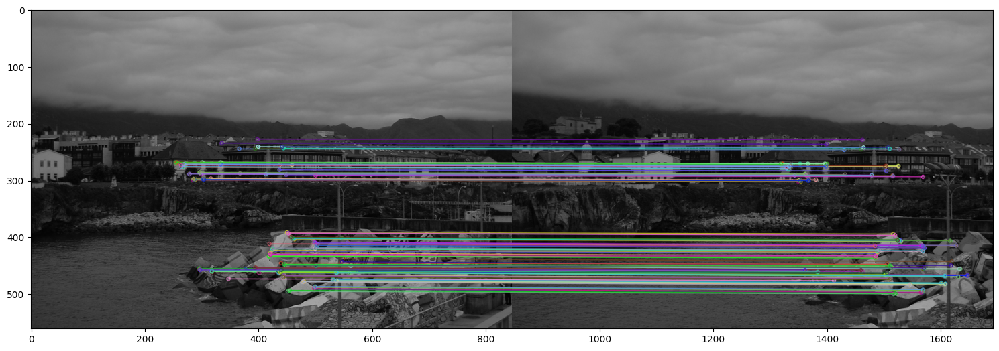

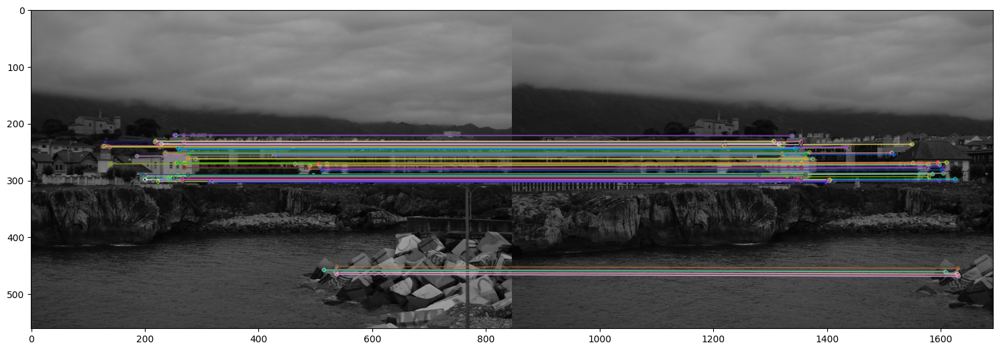

In [4]:
# ORB
# Homography between images 1 and 2
points1 = []
points2 = []
for m in orb_good_matches_12:
    points1.append([kp1_orb[m[0].queryIdx].pt[0], kp1_orb[m[0].queryIdx].pt[1], 1]) # Homogeneous coordinates
    points2.append([kp2_orb[m[0].trainIdx].pt[0], kp2_orb[m[0].trainIdx].pt[1], 1]) # Homogeneous coordinates

points1 = np.asarray(points1)
points1 = points1.T
points2 = np.asarray(points2)
points2 = points2.T

H_12, indices_inlier_matches_12 = Ransac_DLT_homography(points1, points2, 3, 1000) # Play with the threshold 
inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(orb_good_matches_12)

img_12 = cv2.drawMatchesKnn(img1,kp1_orb,img2,kp2_orb,inlier_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_12)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

# Homography between images 2 and 3
points2 = []
points3 = []
for m in orb_good_matches_23:
    points2.append([kp2_orb[m[0].queryIdx].pt[0], kp2_orb[m[0].queryIdx].pt[1], 1])
    points3.append([kp3_orb[m[0].trainIdx].pt[0], kp3_orb[m[0].trainIdx].pt[1], 1])

points2 = np.asarray(points2)
points2 = points2.T
points3 = np.asarray(points3)
points3 = points3.T

H_23, indices_inlier_matches_23 = Ransac_DLT_homography(points2, points3, 3, 1000) # Play with the threshold
inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(orb_good_matches_23)

img_23 = cv2.drawMatchesKnn(img2,kp2_orb,img3,kp3_orb,inlier_matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_23)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

#### SIFT

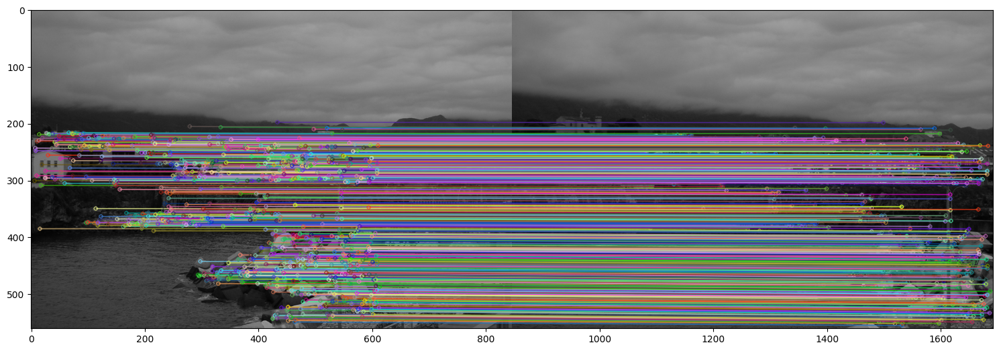

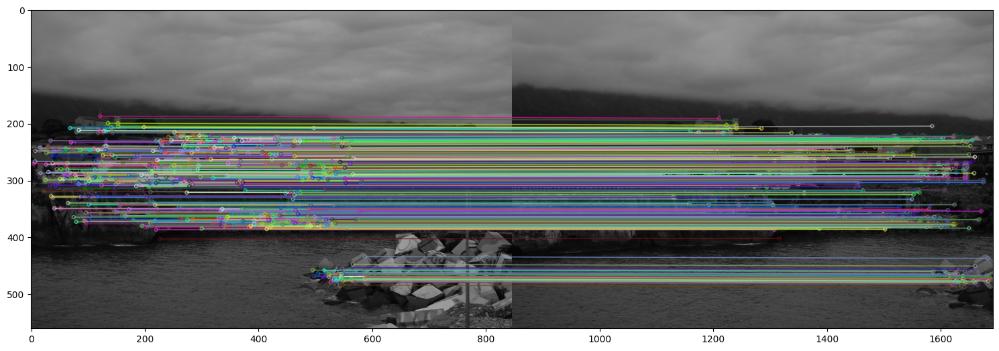

In [5]:
# SIFT
# Homography between images 1 and 2
points1 = []
points2 = []
for m in sift_good_matches_12:
    points1.append([kp1_sift[m[0].queryIdx].pt[0], kp1_sift[m[0].queryIdx].pt[1], 1]) # Homogeneous coordinates
    points2.append([kp2_sift[m[0].trainIdx].pt[0], kp2_sift[m[0].trainIdx].pt[1], 1]) # Homogeneous coordinates

points1 = np.asarray(points1)
points1 = points1.T
points2 = np.asarray(points2)
points2 = points2.T

H_12, indices_inlier_matches_12 = Ransac_DLT_homography(points1, points2, 3, 1000) # Play with the threshold 
inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(sift_good_matches_12)

img_12 = cv2.drawMatchesKnn(img1,kp1_sift,img2,kp2_sift,inlier_matches_12,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_12)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

# Homography between images 2 and 3
points2 = []
points3 = []
for m in sift_good_matches_23:
    points2.append([kp2_sift[m[0].queryIdx].pt[0], kp2_sift[m[0].queryIdx].pt[1], 1])
    points3.append([kp3_sift[m[0].trainIdx].pt[0], kp3_sift[m[0].trainIdx].pt[1], 1])

points2 = np.asarray(points2)
points2 = points2.T
points3 = np.asarray(points3)
points3 = points3.T

H_23, indices_inlier_matches_23 = Ransac_DLT_homography(points2, points3, 3, 1000) # Play with the threshold
inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(sift_good_matches_23)

img_23 = cv2.drawMatchesKnn(img2,kp2_sift,img3,kp3_sift,inlier_matches_23,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.imshow(img_23)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
plt.show()

<span style='color:Blue'>We will use the SIFT descriptor because it provides more robust and reliable feature correspondences under changes in scale, rotation, and illumination, which leads to a more stable homography estimation than ORB.</span> 

## **2. Application: Image mosaics**

Now that the homographies relating the images have been estimated we can create a mosaic by properly transforming and fusing the different image contents.
For that we create a big enough canvas where the mosaic will be created. The function 'apply_H_fixed_image_size' is provided in utils.py, it is a variant of the 'apply_H' function from lab 1 where this time the size of the transformed is fixed and given as an extra input.

<span style='color:Green'> - Adapt the function 'apply_H' from lab 1 so that the canvas size is fixed based on an input array specifying the opposite corner coordinates of the canvas: [xmin, xmax, ymin, ymax] (see 'corners' in the code below). Implement this updated function as 'apply_H_fixed_image_size' in utils.py.</span>

<span style='color:Green'> - Complete the 2nd input argument to the 'apply_H_fixed_image_size' function in order to get the image mosaic. </span>

True

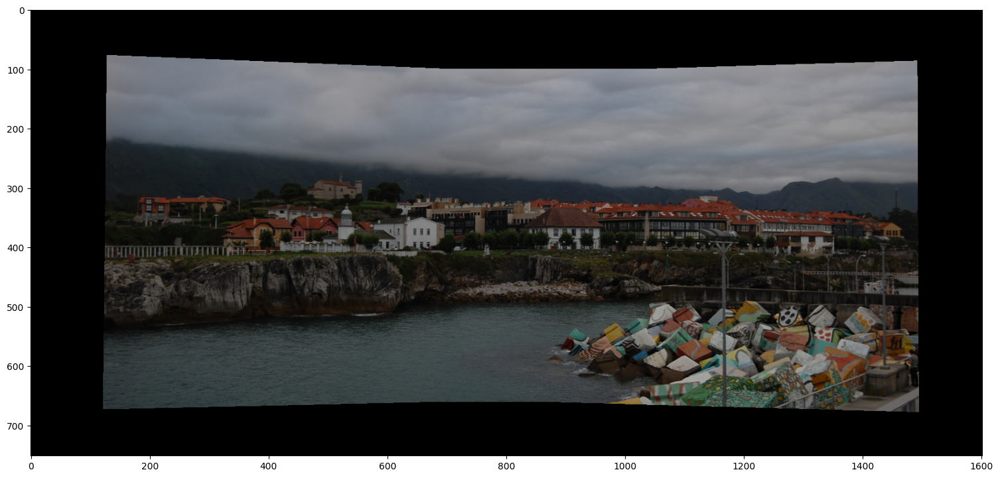

In [6]:
corners = [-400, 1200, -100, 650] # corners of the canvas where the mosaic will be created

img1c = cv2.imread('Data/llanes/llanes_a.jpg',cv2.IMREAD_COLOR)
img2c = cv2.imread('Data/llanes/llanes_b.jpg',cv2.IMREAD_COLOR)
img3c = cv2.imread('Data/llanes/llanes_c.jpg',cv2.IMREAD_COLOR)
img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)

img1c_w = apply_H_fixed_image_size(img1c, H_12, corners) # complete the call to the function
img2c_w = apply_H_fixed_image_size(img2c, np.eye(3), corners) # complete the call to the function
img3c_w = apply_H_fixed_image_size(img3c, np.linalg.inv(H_23), corners) # complete the call to the function

img_mosaic = np.maximum(img3c_w,np.maximum(img1c_w,img2c_w))
plot_img(img_mosaic)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
img_mosaic = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
cv2.imwrite('mosaic_llanes.png', img_mosaic) 


<span style='color:Green'> - Compute the mosaic with images from folder 'castle_int'. </span>



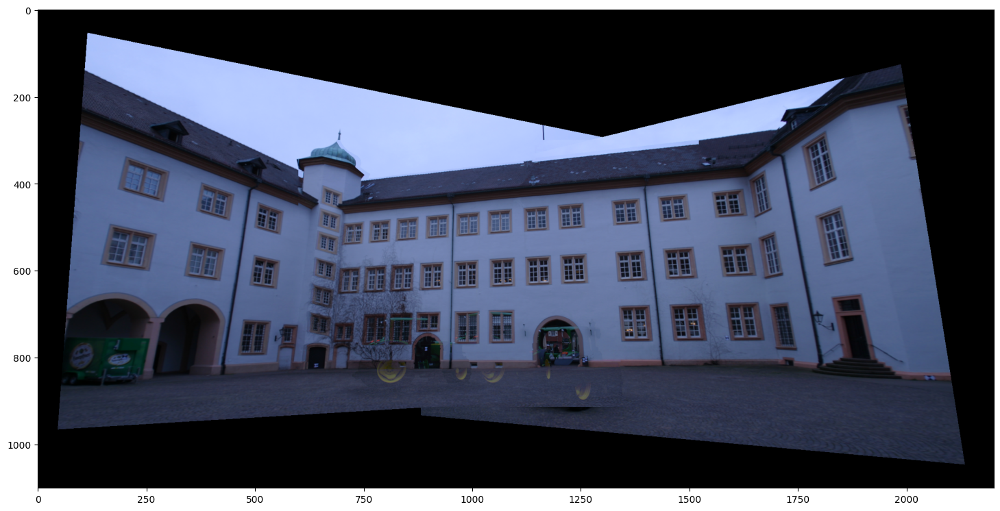

True

In [7]:
# Read images (grayscale for matching)
img1 = cv2.imread('Data/castle_int/0014_s.png', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/castle_int/0015_s.png', cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/castle_int/0016_s.png', cv2.IMREAD_GRAYSCALE)

# SIFT keypoints
sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)
kp3, des3 = sift.detectAndCompute(img3, None)

# Matching + ratio-test
bf = cv2.BFMatcher()

matches_12 = bf.knnMatch(des1, des2, k=2)
good_matches_12 = []
for m, n in matches_12:
    if m.distance < 0.85 * n.distance:
        good_matches_12.append([m])

matches_23 = bf.knnMatch(des2, des3, k=2)
good_matches_23 = []
for m, n in matches_23:
    if m.distance < 0.85 * n.distance:
        good_matches_23.append([m])

# Homography 1 -> 2
points1 = []
points2 = []
for m in good_matches_12:
    points1.append([kp1[m[0].queryIdx].pt[0], kp1[m[0].queryIdx].pt[1], 1])
    points2.append([kp2[m[0].trainIdx].pt[0], kp2[m[0].trainIdx].pt[1], 1])

points1 = np.asarray(points1).T
points2 = np.asarray(points2).T

H_12, inliers_12 = Ransac_DLT_homography(points1, points2, 3, 1000)
inlier_matches_12 = itemgetter(*inliers_12)(good_matches_12)

# Homography 2 -> 3
points2 = []
points3 = []
for m in good_matches_23:
    points2.append([kp2[m[0].queryIdx].pt[0], kp2[m[0].queryIdx].pt[1], 1])
    points3.append([kp3[m[0].trainIdx].pt[0], kp3[m[0].trainIdx].pt[1], 1])

points2 = np.asarray(points2).T
points3 = np.asarray(points3).T

H_23, inliers_23 = Ransac_DLT_homography(points2, points3, 3, 1000)
inlier_matches_23 = itemgetter(*inliers_23)(good_matches_23)

# Read color images
img1c = cv2.imread('Data/castle_int/0014_s.png')
img2c = cv2.imread('Data/castle_int/0015_s.png')
img3c = cv2.imread('Data/castle_int/0016_s.png')

img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)

# Mosaic
corners = [-600, 1600, -300, 800]

img1_w = apply_H_fixed_image_size(img1c, H_12, corners)
img2_w = apply_H_fixed_image_size(img2c, np.eye(3), corners)
img3_w = apply_H_fixed_image_size(img3c, np.linalg.inv(H_23), corners)

img_mosaic = np.maximum(img3_w, np.maximum(img1_w, img2_w))

plt.figure(figsize=(18,10))
plt.imshow(img_mosaic)
plt.show()

img_mosaic_bgr = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
cv2.imwrite('mosaic_castle_int.png', img_mosaic_bgr)


<span style='color:Green'> - Compute the mosaic with images from folder 'aerial'. </span>



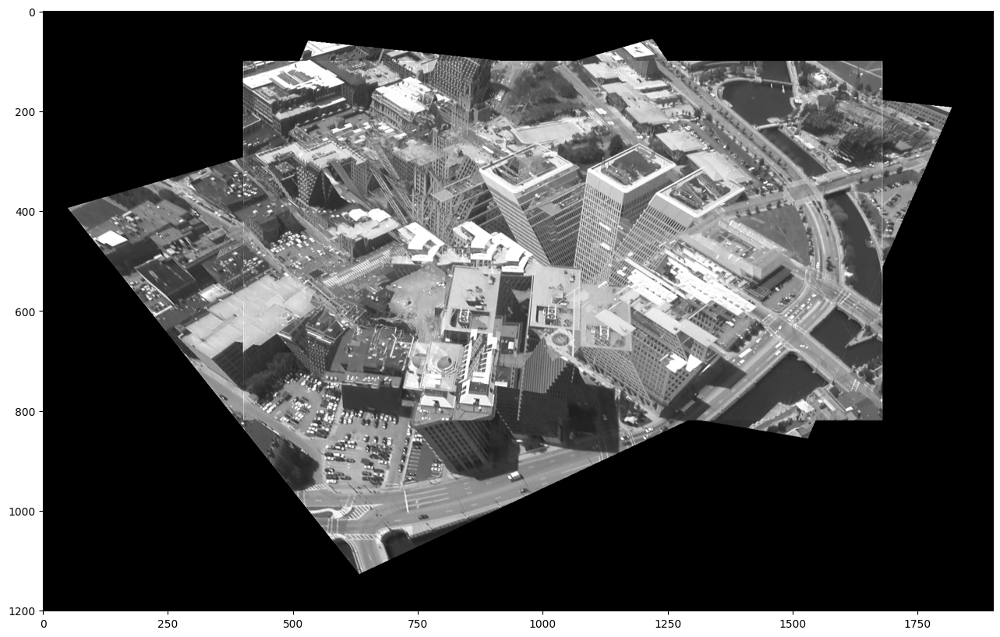

True

In [8]:
# Read images (grayscale for matching)
img1 = cv2.imread('Data/aerial/frame_00001.tif', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/aerial/frame_00018.tif', cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/aerial/frame_00030.tif', cv2.IMREAD_GRAYSCALE)

# SIFT keypoints
sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)
kp3, des3 = sift.detectAndCompute(img3, None)

# Matching + ratio-test
bf = cv2.BFMatcher()

matches_12 = bf.knnMatch(des1, des2, k=2)
good_matches_12 = []
for m, n in matches_12:
    if m.distance < 0.85 * n.distance:
        good_matches_12.append([m])

matches_23 = bf.knnMatch(des2, des3, k=2)
good_matches_23 = []
for m, n in matches_23:
    if m.distance < 0.85 * n.distance:
        good_matches_23.append([m])

# Homography 1 -> 2
points1 = []
points2 = []
for m in good_matches_12:
    points1.append([kp1[m[0].queryIdx].pt[0], kp1[m[0].queryIdx].pt[1], 1])
    points2.append([kp2[m[0].trainIdx].pt[0], kp2[m[0].trainIdx].pt[1], 1])

points1 = np.asarray(points1).T
points2 = np.asarray(points2).T

H_12, inliers_12 = Ransac_DLT_homography(points1, points2, 3, 1000)
inlier_matches_12 = itemgetter(*inliers_12)(good_matches_12)

# Homography 2 -> 3
points2 = []
points3 = []
for m in good_matches_23:
    points2.append([kp2[m[0].queryIdx].pt[0], kp2[m[0].queryIdx].pt[1], 1])
    points3.append([kp3[m[0].trainIdx].pt[0], kp3[m[0].trainIdx].pt[1], 1])

points2 = np.asarray(points2).T
points3 = np.asarray(points3).T

H_23, inliers_23 = Ransac_DLT_homography(points2, points3, 3, 1000)
inlier_matches_23 = itemgetter(*inliers_23)(good_matches_23)

# Read color images
img1c = cv2.imread('Data/aerial/frame_00001.tif')
img2c = cv2.imread('Data/aerial/frame_00018.tif')
img3c = cv2.imread('Data/aerial/frame_00030.tif')

img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)

# Mosaic
corners = [-400, 1500, -100, 1100]

img1_w = apply_H_fixed_image_size(img1c, H_12, corners)
img2_w = apply_H_fixed_image_size(img2c, np.eye(3), corners)
img3_w = apply_H_fixed_image_size(img3c, np.linalg.inv(H_23), corners)

img_mosaic = np.maximum(img3_w, np.maximum(img1_w, img2_w))

plt.figure(figsize=(18,10))
plt.imshow(img_mosaic)
plt.show()

img_mosaic_bgr = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
cv2.imwrite('mosaic_aerial.png', img_mosaic_bgr)


<span style='color:Green'> - Compute the mosaic with 5 images from folder 'ny'. In the report, explain how you combine the five images to create the image mosaic, including which image you use as the reference and the homographies applied to transform each image. </span>



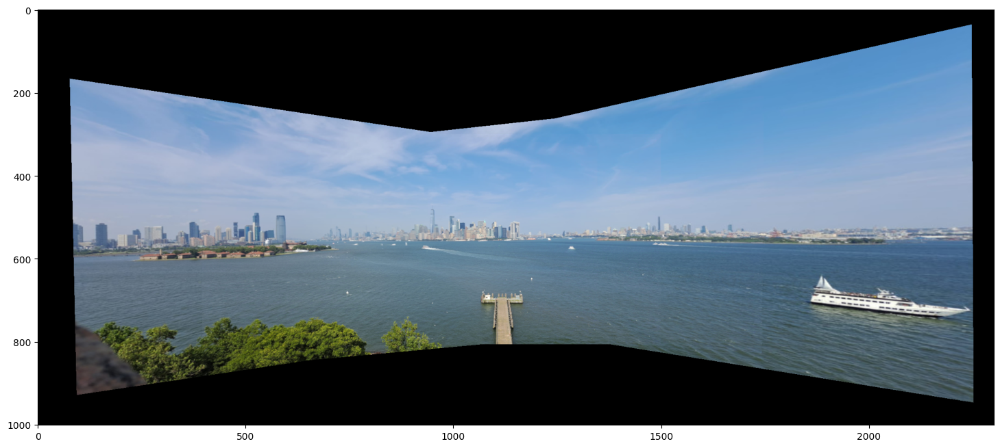

True

In [9]:
# Read images (grayscale for matching)
img1 = cv2.imread('Data/ny/NYs1.jpeg', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/ny/NYs2.jpeg', cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/ny/NYs3.jpeg', cv2.IMREAD_GRAYSCALE)
img4 = cv2.imread('Data/ny/NYs4.jpeg', cv2.IMREAD_GRAYSCALE)
img5 = cv2.imread('Data/ny/NYs5.jpeg', cv2.IMREAD_GRAYSCALE)

# SIFT keypoints
sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)
kp3, des3 = sift.detectAndCompute(img3, None)
kp4, des4 = sift.detectAndCompute(img4, None)
kp5, des5 = sift.detectAndCompute(img5, None)

# Matching + ratio-test
bf = cv2.BFMatcher()

matches_12 = bf.knnMatch(des1, des2, k=2)
good_matches_12 = []
for m, n in matches_12:
    if m.distance < 0.85 * n.distance:
        good_matches_12.append([m])

matches_23 = bf.knnMatch(des2, des3, k=2)
good_matches_23 = []
for m, n in matches_23:
    if m.distance < 0.85 * n.distance:
        good_matches_23.append([m])

matches_34 = bf.knnMatch(des3, des4, k=2)
good_matches_34 = []
for m, n in matches_34:
    if m.distance < 0.85 * n.distance:
        good_matches_34.append([m])

matches_45 = bf.knnMatch(des4, des5, k=2)
good_matches_45 = []
for m, n in matches_45:
    if m.distance < 0.85 * n.distance:
        good_matches_45.append([m])

# Homography 1 -> 2
points1 = []
points2 = []
for m in good_matches_12:
    points1.append([kp1[m[0].queryIdx].pt[0], kp1[m[0].queryIdx].pt[1], 1])
    points2.append([kp2[m[0].trainIdx].pt[0], kp2[m[0].trainIdx].pt[1], 1])

points1 = np.asarray(points1).T
points2 = np.asarray(points2).T

H_12, inliers_12 = Ransac_DLT_homography(points1, points2, 3, 1000)
inlier_matches_12 = itemgetter(*inliers_12)(good_matches_12)

# Homography 2 -> 3
points2 = []
points3 = []
for m in good_matches_23:
    points2.append([kp2[m[0].queryIdx].pt[0], kp2[m[0].queryIdx].pt[1], 1])
    points3.append([kp3[m[0].trainIdx].pt[0], kp3[m[0].trainIdx].pt[1], 1])

points2 = np.asarray(points2).T
points3 = np.asarray(points3).T

H_23, inliers_23 = Ransac_DLT_homography(points2, points3, 3, 1000)
inlier_matches_23 = itemgetter(*inliers_23)(good_matches_23)

# Homography 3 -> 4
points3 = []
points4 = []
for m in good_matches_34:
    points3.append([kp3[m[0].queryIdx].pt[0], kp3[m[0].queryIdx].pt[1], 1])
    points4.append([kp4[m[0].trainIdx].pt[0], kp4[m[0].trainIdx].pt[1], 1])

points3 = np.asarray(points3).T
points4 = np.asarray(points4).T

H_34, inliers_34 = Ransac_DLT_homography(points3, points4, 3, 1000)
inlier_matches_34 = itemgetter(*inliers_34)(good_matches_34)

# Homography 4 -> 5
points4 = []
points5 = []
for m in good_matches_45:
    points4.append([kp4[m[0].queryIdx].pt[0], kp4[m[0].queryIdx].pt[1], 1])
    points5.append([kp5[m[0].trainIdx].pt[0], kp5[m[0].trainIdx].pt[1], 1])

points4 = np.asarray(points4).T
points5 = np.asarray(points5).T

H_45, inliers_45 = Ransac_DLT_homography(points4, points5, 3, 1000)
inlier_matches_45 = itemgetter(*inliers_45)(good_matches_45)

# Read color images
img1c = cv2.imread('Data/ny/NYs1.jpeg')
img2c = cv2.imread('Data/ny/NYs2.jpeg')
img3c = cv2.imread('Data/ny/NYs3.jpeg')
img4c = cv2.imread('Data/ny/NYs4.jpeg')
img5c = cv2.imread('Data/ny/NYs5.jpeg')

img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)
img4c = cv2.cvtColor(img4c, cv2.COLOR_BGR2RGB)
img5c = cv2.cvtColor(img5c, cv2.COLOR_BGR2RGB)

# Mosaic
corners = [-600, 1700, -300, 700]

img1_w = apply_H_fixed_image_size(img1c, H_23 @ H_12, corners)
img2_w = apply_H_fixed_image_size(img2c, H_23, corners)
img3_w = apply_H_fixed_image_size(img3c, np.eye(3), corners)
img4_w = apply_H_fixed_image_size(img4c, np.linalg.inv(H_34), corners)
img5_w = apply_H_fixed_image_size(img5c, np.linalg.inv(H_34) @ np.linalg.inv(H_45), corners)

img_mosaic = np.maximum.reduce([img1_w, img2_w, img3_w, img4_w, img5_w])

plt.figure(figsize=(18,10))
plt.imshow(img_mosaic)
plt.show()

img_mosaic_bgr = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
cv2.imwrite('mosaic_ny.png', img_mosaic_bgr)


<span style='color:Green'> - In the report, comment the results in every of the four cases: hypothetise why it works or does not work </span>

## **3. Refinement of the estimated homography with the Gold Standard algorithm**

In order to refine the previous estimated homography we can minimize the geometric error with the Levenberg-Marquardt algorithm. For that we will call the function 'least_squares' with the proper input arguments that you have to complete. First, it is recommended to read the documentation of that function:

https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html

Notice that the first input is a function that only provides the vector of the residuals. The algorithm constructs the cost function as a sum of squares of the residuals. In our case the function is called 'geometric_error_terms' and you need to complete it.

More precisely, the tasks to perform are:

<span style='color:Green'> - Complete the function 'geometric_error_terms'. </span>

<span style='color:Green'> - Complete the code before calling function 'geometric_error_terms' in order to create the proper input of variables, 'variables0', to pass to the function. </span>

<span style='color:Green'> - Extract the refined homogaphy and the refined keypoint locations from the output, 'result', of function 'geometric_error_terms'.  </span>

<span style='color:Green'> - To better compare the two homographies (refined and non refined) compute and print the geometric error before and after the refinement. </span>

Initial Geometric Error: 100.7652
Final Geometric Error: 49.0744


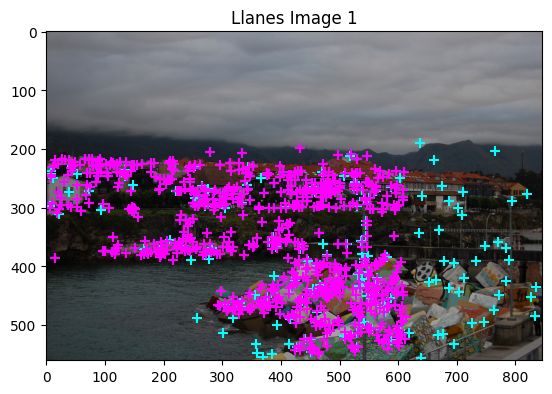

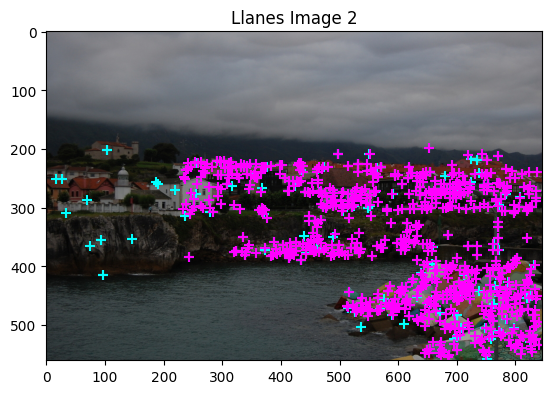

In [10]:
from scipy.optimize import least_squares
from math import ceil

# Read images for H_23 estimation
img1c = cv2.imread('Data/llanes/llanes_a.jpg', cv2.IMREAD_GRAYSCALE)
img2c = cv2.imread('Data/llanes/llanes_b.jpg', cv2.IMREAD_GRAYSCALE)
img3c = cv2.imread('Data/llanes/llanes_c.jpg', cv2.IMREAD_GRAYSCALE)

# SIFT detector
sift = cv2.SIFT_create()
kp1_sift, des1_sift = sift.detectAndCompute(img1c, None)
kp2_sift, des2_sift = sift.detectAndCompute(img2c, None)
kp3_sift, des3_sift = sift.detectAndCompute(img3c, None)

# Matching
bf = cv2.BFMatcher()
sift_matches_12 = bf.knnMatch(des1_sift, des2_sift, k=2)
sift_matches_23 = bf.knnMatch(des2_sift, des3_sift, k=2)


# Ratio test
sift_good_matches_12 = []
for m, n in sift_matches_12:
    if m.distance < 0.85 * n.distance:
        sift_good_matches_12.append([m])

sift_good_matches_23 = []
for m, n in sift_matches_23:
    if m.distance < 0.85 * n.distance:
        sift_good_matches_23.append([m])

# Build correspondence points
points1 = []
points2 = []
for m in sift_good_matches_12:
    points1.append([kp1_sift[m[0].queryIdx].pt[0], kp1_sift[m[0].queryIdx].pt[1], 1])
    points2.append([kp2_sift[m[0].trainIdx].pt[0], kp2_sift[m[0].trainIdx].pt[1], 1])

points1 = np.asarray(points1).T
points2 = np.asarray(points2).T

# Estimate homography with RANSAC
H_12, indices_inlier_matches_12 = Ransac_DLT_homography(points1, points2, 3, 1000)
inlier_matches_12 = itemgetter(*indices_inlier_matches_12)(sift_good_matches_12)
H = H_12


def geometric_error_terms(variables, data_points):
    """
    variables: Vector 1D containing the firts 9 elements of H and the estimated points
    """
    
    # Extract H and estimated points
    H = variables[:9].reshape(3, 3)
    num_points = data_points.shape[1]
    hat_x = variables[9:].reshape(2, num_points)
    
    # Compute the projection hat(x)' = H * homogeneus_cords(hat(x))
    hat_x_hom = np.vstack((hat_x, np.ones((1, num_points))))
    hat_x_prime_hom = H @ hat_x_hom
    
    # Normalize to get inhomogeneous coordinates
    hat_x_prime = hat_x_prime_hom[:2, :] / hat_x_prime_hom[2, :]
    

    # Compute residuals

    # Error in the first image
    observed_x = data_points[:2, :]
    error_img1 = (observed_x - hat_x).flatten()
    
    # Error in the second image
    observed_x_prime = data_points[2:4, :]
    error_img2 = (observed_x_prime - hat_x_prime).flatten()
    
    # Return errors
    return np.concatenate((error_img1, error_img2))


# Initialize variables
inliers_idx = indices_inlier_matches_12.astype(int)

points1_inliers = points1[:, inliers_idx]
points2_inliers = points2[:, inliers_idx]

points1_cart = points1_inliers[:2, :] 
points2_cart = points2_inliers[:2, :]

h_initial = H.flatten()
points_initial = points1_cart.flatten()

variables0 = np.concatenate((h_initial, points_initial))

points_stacked = np.vstack((points1_cart, points2_cart))

result = least_squares(geometric_error_terms, variables0, method='lm', args=([points_stacked]))

# From result extract refined homography and the refined keypoint locations ...
opt_params = result.x
H_refined = opt_params[:9].reshape(3, 3)
# Normalize
H_refined = H_refined / H_refined[2, 2]

# Keypoints from img1
points1r = opt_params[9:].reshape(2, -1)

# Refined points from 2nd image
ones = np.ones((1, points1r.shape[1]))
points1r_hom = np.vstack((points1r, ones))
points2r_hom = H_refined @ points1r_hom
points2r = points2r_hom[:2, :] / points2r_hom[2, :]

# Print initial and final square errors ...
initial_residuals = geometric_error_terms(variables0, points_stacked)
initial_sq_error = np.sum(initial_residuals**2)

final_residuals = result.fun
final_sq_error = np.sum(final_residuals**2)

print(f"Initial Geometric Error: {initial_sq_error:.4f}")
print(f"Final Geometric Error: {final_sq_error:.4f}")

img1c_color = cv2.imread('Data/llanes/llanes_a.jpg', cv2.IMREAD_COLOR)
img2c_color = cv2.imread('Data/llanes/llanes_b.jpg', cv2.IMREAD_COLOR)
img1c_color = cv2.cvtColor(img1c_color, cv2.COLOR_BGR2RGB)
img2c_color = cv2.cvtColor(img2c_color, cv2.COLOR_BGR2RGB)

# Display points and refined points
fig, ax = plt.subplots() # image 1
ax.set_title("Llanes Image 1")
ax.imshow(img1c_color)
ax.scatter(points1[0,:],points1[1,:], c='cyan', marker='+', s=50)
ax.scatter(points1r[0,:],points1r[1,:], c='fuchsia', marker='+', s=50)
plt.show()

fig, ax = plt.subplots() # image 2
ax.set_title("Llanes Image 2")
ax.imshow(img2c_color)
ax.scatter(points2[0,:],points2[1,:], c='cyan', marker='+', s=50)
ax.scatter(points2r[0,:],points2r[1,:], c='fuchsia', marker='+', s=50)
plt.show()

<span style='color:Green'> - Refine the homography 23 with the Gold Standard algorithm and visualize the differences in the keypoint locations. </span>

Initial Geometric Error: 42.3814
Final Geometric Error: 21.0980


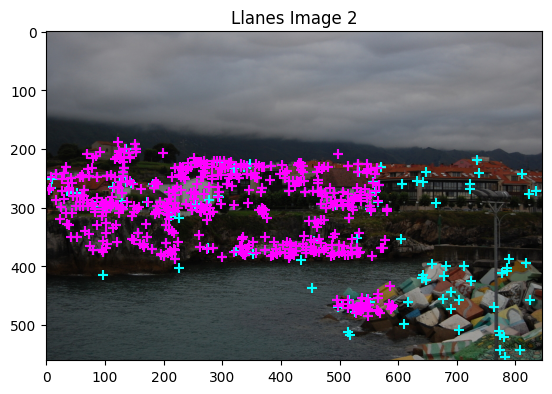

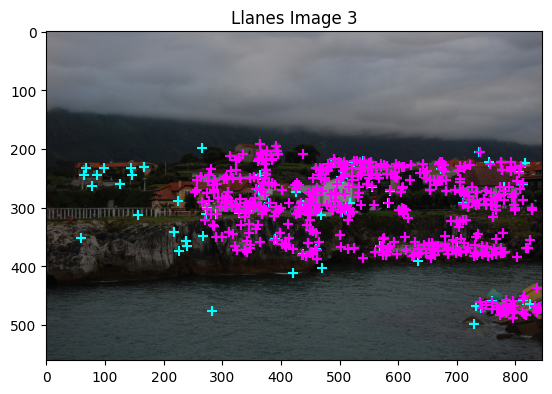

In [11]:
# Build correspondence points
points2 = []
points3 = []
for m in sift_good_matches_23:
    points2.append([kp2_sift[m[0].queryIdx].pt[0], kp2_sift[m[0].queryIdx].pt[1], 1])
    points3.append([kp3_sift[m[0].trainIdx].pt[0], kp3_sift[m[0].trainIdx].pt[1], 1])

points2 = np.asarray(points2).T
points3 = np.asarray(points3).T

# Estimate homography with RANSAC
H_23, indices_inlier_matches_23 = Ransac_DLT_homography(points2, points3, 3, 1000)
inlier_matches_23 = itemgetter(*indices_inlier_matches_23)(sift_good_matches_23)
H = H_23

# Initialize variables
inliers_idx = indices_inlier_matches_23.astype(int)

points2_inliers = points2[:, inliers_idx]
points3_inliers = points3[:, inliers_idx]

points2_cart = points2_inliers[:2, :] 
points3_cart = points3_inliers[:2, :]

h_initial = H.flatten()
points_initial = points2_cart.flatten()

variables0 = np.concatenate((h_initial, points_initial))

points_stacked = np.vstack((points2_cart, points3_cart))

result = least_squares(geometric_error_terms, variables0, method='lm', args=([points_stacked]))

# From result extract refined homography and the refined keypoint locations ...
opt_params = result.x
H_refined = opt_params[:9].reshape(3, 3)

# Normalize
H_refined = H_refined / H_refined[2, 2]

# Keypoints from img2
points2r = opt_params[9:].reshape(2, -1)

# Refined points from 2nd image
ones = np.ones((1, points2r.shape[1]))
points2r_hom = np.vstack((points2r, ones))
points3r_hom = H_refined @ points2r_hom
points3r = points3r_hom[:2, :] / points3r_hom[2, :]

# Print initial and final square errors ...
initial_residuals = geometric_error_terms(variables0, points_stacked)
initial_sq_error = np.sum(initial_residuals**2)

final_residuals = result.fun
final_sq_error = np.sum(final_residuals**2)

print(f"Initial Geometric Error: {initial_sq_error:.4f}")
print(f"Final Geometric Error: {final_sq_error:.4f}")


img2c_color = cv2.imread('Data/llanes/llanes_b.jpg', cv2.IMREAD_COLOR)
img3c_color = cv2.imread('Data/llanes/llanes_c.jpg', cv2.IMREAD_COLOR)
img2c_color = cv2.cvtColor(img2c_color, cv2.COLOR_BGR2RGB)
img3c_color = cv2.cvtColor(img3c_color, cv2.COLOR_BGR2RGB)

# Display points and refined points
fig, ax = plt.subplots() # image 2
ax.set_title("Llanes Image 2")
ax.imshow(img2c_color)
ax.scatter(points2[0,:],points2[1,:], c='cyan', marker='+', s=50)
ax.scatter(points2r[0,:],points2r[1,:], c='fuchsia', marker='+', s=50)
plt.show()

fig, ax = plt.subplots() # image 3
ax.set_title("Llanes Image 3")
ax.imshow(img3c_color)
ax.scatter(points3[0,:],points3[1,:], c='cyan', marker='+', s=50)
ax.scatter(points3r[0,:],points3r[1,:], c='fuchsia', marker='+', s=50)
plt.show()

<span style='color:Green'> - Build mosaic with the refined homographies. </span>

In [12]:
def get_gold_standard_homography(img1, img2, name="H"):
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(img1, None)
    kp2, des2 = sift.detectAndCompute(img2, None)

    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1, des2, k=2)
    good = []
    for m, n in matches:
        if m.distance < 0.85 * n.distance:
            good.append([m])
            
    points1 = []
    points2 = []
    for m in good:
        points1.append([kp1[m[0].queryIdx].pt[0], kp1[m[0].queryIdx].pt[1], 1])
        points2.append([kp2[m[0].trainIdx].pt[0], kp2[m[0].trainIdx].pt[1], 1])

    points1 = np.asarray(points1).T
    points2 = np.asarray(points2).T

        
    H_init, inliers_idx = Ransac_DLT_homography(points1, points2, 3, 1000)
    
    idx = inliers_idx.astype(int)
    pts1_in = points1[:2, idx] # (2, N)
    pts2_in = points2[:2, idx] # (2, N)
    
    h_params = H_init.flatten()
    points_params = pts1_in.flatten()
    vars0 = np.concatenate((h_params, points_params))
    data_points = np.vstack((pts1_in, pts2_in))
    

    initial_residuals = geometric_error_terms(vars0, data_points)
    initial_error = np.sum(initial_residuals**2)
    
    res = least_squares(geometric_error_terms, vars0, method='lm', args=(data_points,))
    
    final_error = np.sum(res.fun**2)
    
    print(f"Computing {name}: Initial Geometric Error: {initial_error:.4f} | Final Geometric Error: {final_error:.4f}")
    
    H_refined = res.x[:9].reshape(3, 3)
    H_refined /= H_refined[2, 2]
    
    return H_refined

Computing H_12: Initial Geometric Error: 101.0836 | Final Geometric Error: 49.2252
Computing H_23: Initial Geometric Error: 37.0832 | Final Geometric Error: 18.3247


True

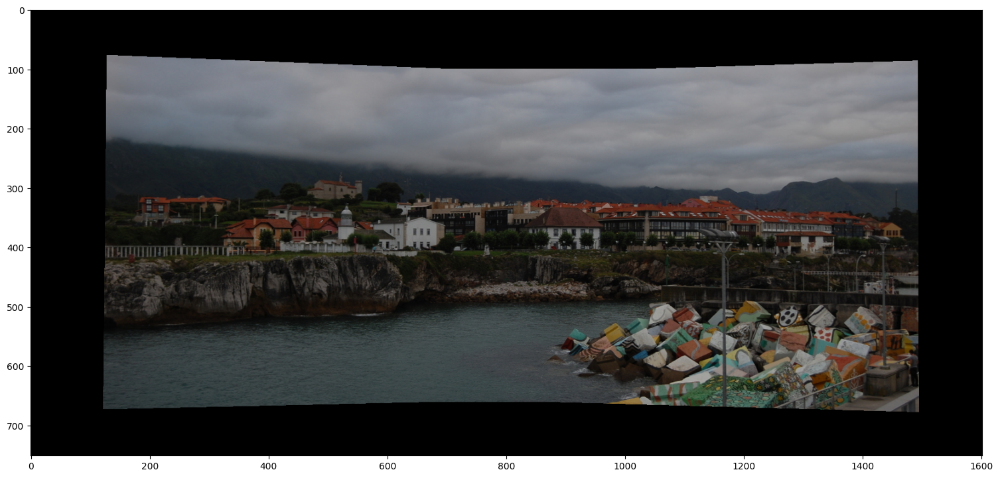

In [13]:
corners = [-400, 1200, -100, 650]

img1c = cv2.imread('Data/llanes/llanes_a.jpg',cv2.IMREAD_COLOR)
img2c = cv2.imread('Data/llanes/llanes_b.jpg',cv2.IMREAD_COLOR)
img3c = cv2.imread('Data/llanes/llanes_c.jpg',cv2.IMREAD_COLOR)

img1_g = cv2.cvtColor(img1c, cv2.COLOR_BGR2GRAY)
img2_g = cv2.cvtColor(img2c, cv2.COLOR_BGR2GRAY)
img3_g = cv2.cvtColor(img3c, cv2.COLOR_BGR2GRAY)

H_12 = get_gold_standard_homography(img1_g, img2_g, "H_12")
H_23 = get_gold_standard_homography(img2_g, img3_g, "H_23")

img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)

img1c_w = apply_H_fixed_image_size(img1c, H_12, corners)
img2c_w = apply_H_fixed_image_size(img2c, np.eye(3), corners)
img3c_w = apply_H_fixed_image_size(img3c, np.linalg.inv(H_23), corners)

img_mosaic = np.maximum(img3c_w,np.maximum(img1c_w,img2c_w))
plot_img(img_mosaic)
fig = matplotlib.pyplot.gcf()
fig.set_size_inches(18.5, 10.5)
img_mosaic = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
cv2.imwrite('mosaic_llanes_gs.png', img_mosaic)

Computing H_12: Initial Geometric Error: 119.1470 | Final Geometric Error: 55.5035
Computing H_23: Initial Geometric Error: 162.1026 | Final Geometric Error: 98.5490


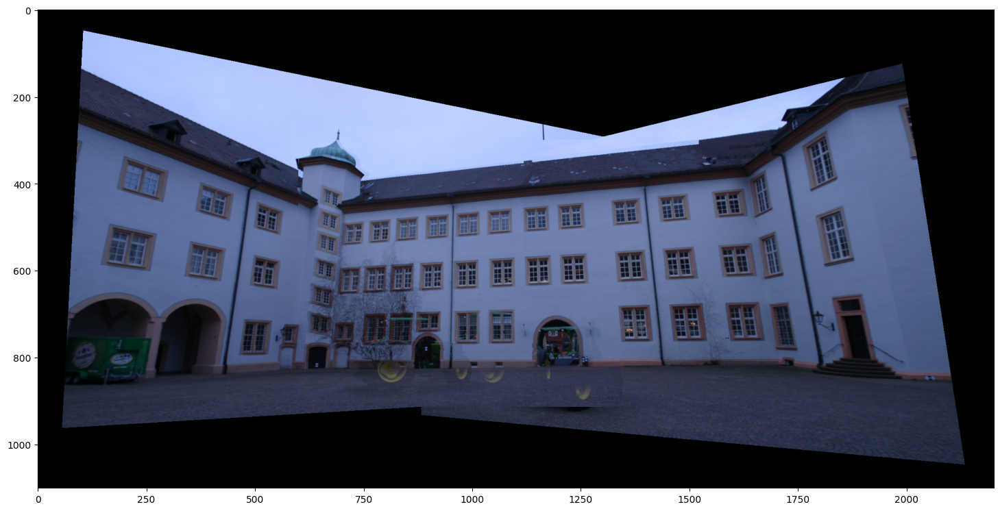

True

In [14]:
img1 = cv2.imread('Data/castle_int/0014_s.png', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/castle_int/0015_s.png', cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/castle_int/0016_s.png', cv2.IMREAD_GRAYSCALE)

H_12 = get_gold_standard_homography(img1, img2, "H_12")
H_23 = get_gold_standard_homography(img2, img3, "H_23")

img1c = cv2.imread('Data/castle_int/0014_s.png')
img2c = cv2.imread('Data/castle_int/0015_s.png')
img3c = cv2.imread('Data/castle_int/0016_s.png')

img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)

corners = [-600, 1600, -300, 800]

img1_w = apply_H_fixed_image_size(img1c, H_12, corners)
img2_w = apply_H_fixed_image_size(img2c, np.eye(3), corners)
img3_w = apply_H_fixed_image_size(img3c, np.linalg.inv(H_23), corners)

img_mosaic = np.maximum(img3_w, np.maximum(img1_w, img2_w))

plt.figure(figsize=(18,10))
plt.imshow(img_mosaic)
plt.show()

img_mosaic_bgr = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
cv2.imwrite('mosaic_castle_int_gs.png', img_mosaic_bgr)

Computing H_12: Initial Geometric Error: 108.1592 | Final Geometric Error: 55.0600
Computing H_23: Initial Geometric Error: 549.1318 | Final Geometric Error: 255.3386


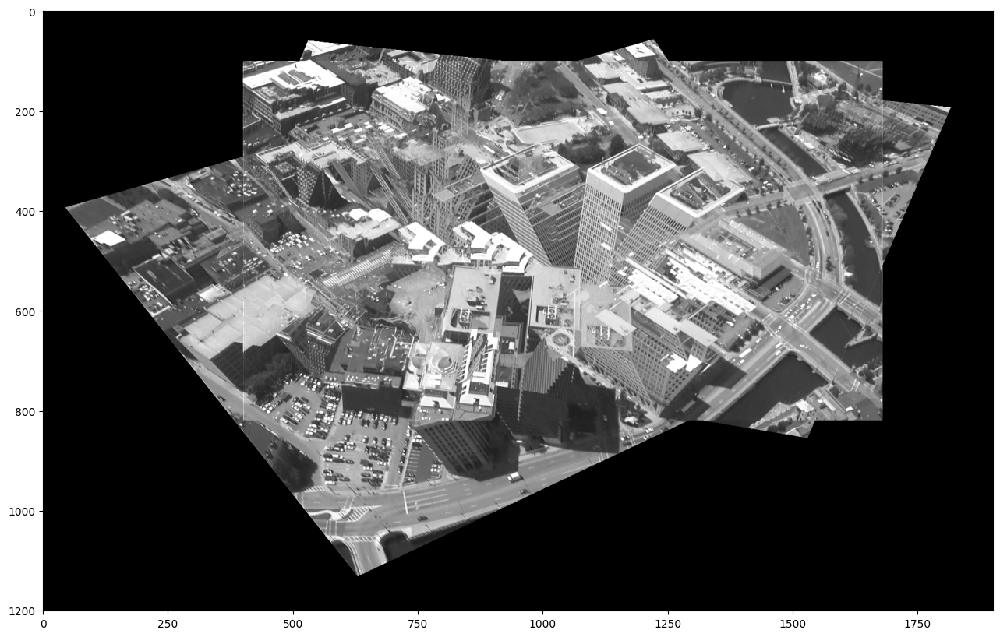

True

In [15]:
img1 = cv2.imread('Data/aerial/frame_00001.tif', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/aerial/frame_00018.tif', cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/aerial/frame_00030.tif', cv2.IMREAD_GRAYSCALE)

H_12 = get_gold_standard_homography(img1, img2, "H_12")
H_23 = get_gold_standard_homography(img2, img3, "H_23")

img1c = cv2.imread('Data/aerial/frame_00001.tif')
img2c = cv2.imread('Data/aerial/frame_00018.tif')
img3c = cv2.imread('Data/aerial/frame_00030.tif')

img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)

corners = [-400, 1500, -100, 1100]

img1_w = apply_H_fixed_image_size(img1c, H_12, corners)
img2_w = apply_H_fixed_image_size(img2c, np.eye(3), corners)
img3_w = apply_H_fixed_image_size(img3c, np.linalg.inv(H_23), corners)

img_mosaic = np.maximum(img3_w, np.maximum(img1_w, img2_w))

plt.figure(figsize=(18,10))
plt.imshow(img_mosaic)
plt.show()

img_mosaic_bgr = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
cv2.imwrite('mosaic_aerial_gs.png', img_mosaic_bgr)

Computing H_12: Initial Geometric Error: 177.1794 | Final Geometric Error: 87.0133
Computing H_23: Initial Geometric Error: 122.2469 | Final Geometric Error: 62.0091
Computing H_34: Initial Geometric Error: 56.9709 | Final Geometric Error: 29.0795
Computing H_45: Initial Geometric Error: 115.3529 | Final Geometric Error: 55.1761


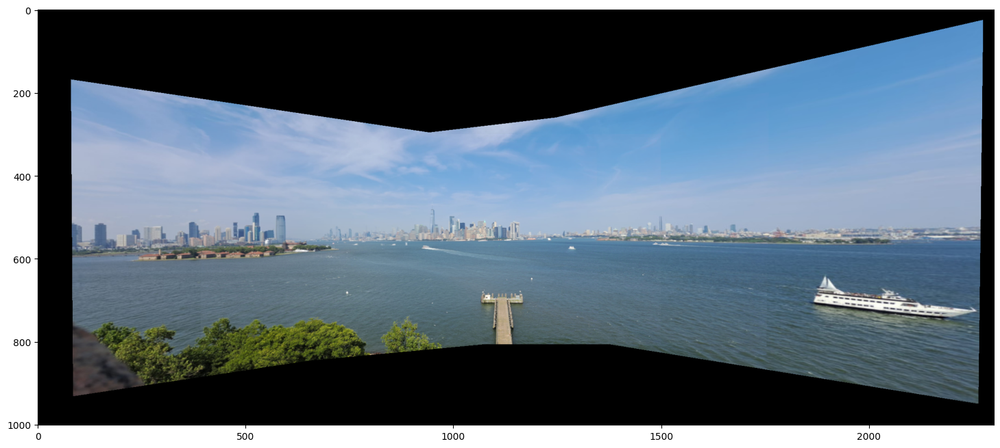

True

In [16]:
img1 = cv2.imread('Data/ny/NYs1.jpeg', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('Data/ny/NYs2.jpeg', cv2.IMREAD_GRAYSCALE)
img3 = cv2.imread('Data/ny/NYs3.jpeg', cv2.IMREAD_GRAYSCALE)
img4 = cv2.imread('Data/ny/NYs4.jpeg', cv2.IMREAD_GRAYSCALE)
img5 = cv2.imread('Data/ny/NYs5.jpeg', cv2.IMREAD_GRAYSCALE)

H_12 = get_gold_standard_homography(img1, img2, "H_12")
H_23 = get_gold_standard_homography(img2, img3, "H_23")
H_34 = get_gold_standard_homography(img3, img4, "H_34")
H_45 = get_gold_standard_homography(img4, img5, "H_45")

img1c = cv2.imread('Data/ny/NYs1.jpeg')
img2c = cv2.imread('Data/ny/NYs2.jpeg')
img3c = cv2.imread('Data/ny/NYs3.jpeg')
img4c = cv2.imread('Data/ny/NYs4.jpeg')
img5c = cv2.imread('Data/ny/NYs5.jpeg')

img1c = cv2.cvtColor(img1c, cv2.COLOR_BGR2RGB)
img2c = cv2.cvtColor(img2c, cv2.COLOR_BGR2RGB)
img3c = cv2.cvtColor(img3c, cv2.COLOR_BGR2RGB)
img4c = cv2.cvtColor(img4c, cv2.COLOR_BGR2RGB)
img5c = cv2.cvtColor(img5c, cv2.COLOR_BGR2RGB)

corners = [-600, 1700, -300, 700]

img1_w = apply_H_fixed_image_size(img1c, H_23 @ H_12, corners)
img2_w = apply_H_fixed_image_size(img2c, H_23, corners)
img3_w = apply_H_fixed_image_size(img3c, np.eye(3), corners)
img4_w = apply_H_fixed_image_size(img4c, np.linalg.inv(H_34), corners)
img5_w = apply_H_fixed_image_size(img5c, np.linalg.inv(H_34) @ np.linalg.inv(H_45), corners)

img_mosaic = np.maximum.reduce([img1_w, img2_w, img3_w, img4_w, img5_w])

plt.figure(figsize=(18,10))
plt.imshow(img_mosaic)
plt.show()

img_mosaic_bgr = cv2.cvtColor(img_mosaic, cv2.COLOR_RGB2BGR)
cv2.imwrite('mosaic_ny_gs.png', img_mosaic_bgr)

## **4. Application: Calibration with a planar pattern and augmented reality**

As we have seen in class, we can calibrate a camera with a planar pattern with Zhang's algorithm. A key aspect of this algorithm is the estimation of a homography that relates a pair of images, in particular, the template image and an image of it taken with the camera we want to calibrate. Once the camera is calibrated and we have recovered the relative pose between the camera and the planar pattern we can properly insert a virtual object on top of the flat pattern in a way that it is consistent, in a perspective sense, with rest of the scene.

### **4.1 Camera calibration**

The following code calibrates a camera using N (where N greater or equal than three) views of the planar pattern. Most of the code is provided but there are parts you need to complete. These parts are indicated in green before the corresponding cell code.


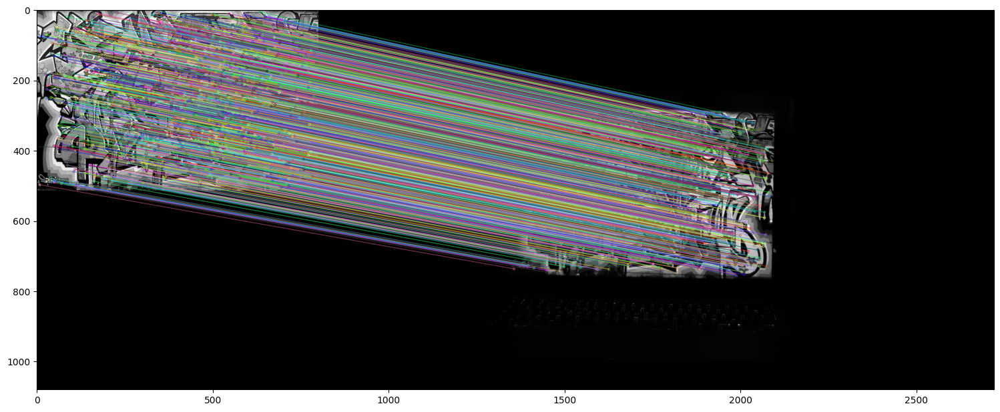

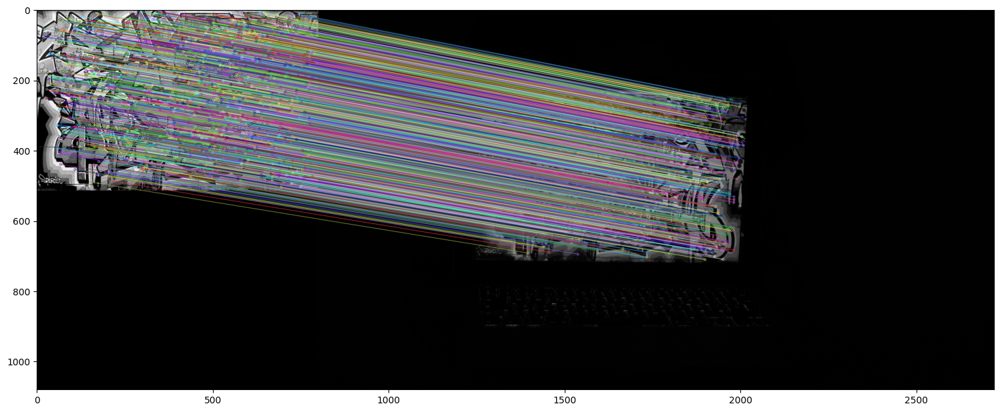

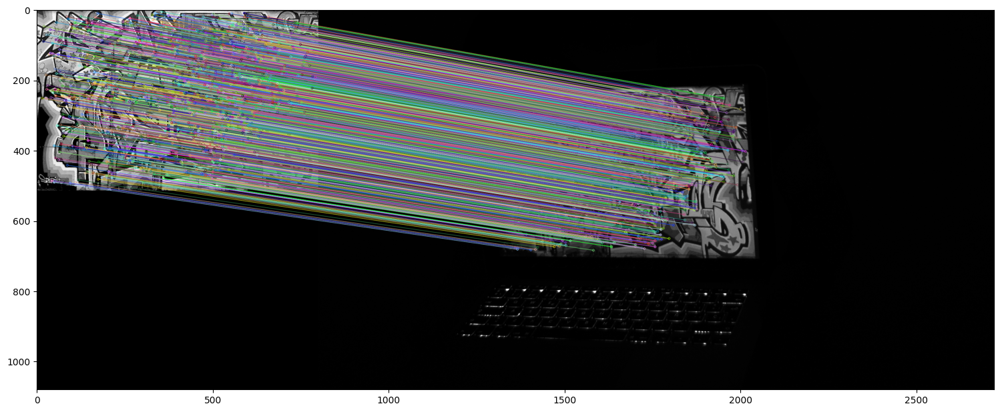

In [17]:
# Read template image and calibration images
template = cv2.imread('Data/calib/template.jpg',cv2.IMREAD_GRAYSCALE)
images = []
N = 3 # 3, 4, or 5
for i in range(1,N+1):
    m = cv2.imread("Data/calib/graffiti{0}.tif".format(i),cv2.IMREAD_GRAYSCALE)
    images.append(m)

# Initiate SIFT detector
sift = cv2.SIFT_create()
# Find the keypoints and descriptors with SIFT
kpt, dest = sift.detectAndCompute(template,None)
kpi, desi = [], []
for m in images:
    kp, des = sift.detectAndCompute(m,None)
    kpi.append(kp)
    desi.append(des)

# Keypoint matching and homography estimation
bf = cv2.BFMatcher()
H = []
H_ref = []
for i in range(N):
    matches = bf.knnMatch(dest,desi[i],k=2)
    # Apply ratio test
    good_matches = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good_matches.append([m])
    
    # Fit homography and remove outliers
    points1 = []
    points2 = []
    for m in good_matches:
        points1.append([kpt[m[0].queryIdx].pt[0], kpt[m[0].queryIdx].pt[1], 1])
        points2.append([kpi[i][m[0].trainIdx].pt[0], kpi[i][m[0].trainIdx].pt[1], 1])
    
    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T
    
    Hi, indices_inlier_matches = Ransac_DLT_homography(points1, points2, 3, 1000)
    H.append(Hi)
    
    # Show inlier matches
    inlier_matches = itemgetter(*indices_inlier_matches)(good_matches)
    img_12 = cv2.drawMatchesKnn(template,kpt,images[i],kpi[i],inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()
    


<span style='color:Green'> - Complete the code that computes the Image of the Absolute Conic. </span>

<span style='color:Green'> - Complete the code that computes the matrix of internal parameters, K. </span>

Note: there is a linalg.cholesky function both in numpy and scipy, you have to read the documentation of both and find out which is the proper one to use here.

<span style='color:Green'> - In the report, make some comments related to the obtained internal camera parameters and also comment their relation to the image size. </span>

In [18]:
# Compute the Image of the Absolute Conic ...

def get_v_ij(h, i, j):
    return np.array([
        h[0,i]*h[0,j],
        h[0,i]*h[1,j] + h[1,i]*h[0,j],
        h[1,i]*h[1,j],
        h[2,i]*h[0,j] + h[0,i]*h[2,j],
        h[2,i]*h[1,j] + h[1,i]*h[2,j],
        h[2,i]*h[2,j]
    ])

V = []
for Hi in H:
    v12 = get_v_ij(Hi, 0, 1) # h1^T * w * h2 = 0  -> v_12 * b = 0
    v11 = get_v_ij(Hi, 0, 0) # h1^T * w * h1 - h2^T * w * h2 = 0 -> (v_11 - v_22) * b = 0
    v22 = get_v_ij(Hi, 1, 1)
    
    V.append(v12)
    V.append(v11 - v22)

V = np.array(V)

U, S, Vt = np.linalg.svd(V)
b = Vt[-1]

# b = [B11, B12, B22, B13, B23, B33]
omega = np.array([
    [b[0], b[1], b[3]],
    [b[1], b[2], b[4]],
    [b[3], b[4], b[5]]
])


# Compute the matrix of internal parameters, K ...

from scipy import linalg

if np.linalg.det(omega) < 0 or omega[0,0] < 0:  # It needs to be positive definite
    omega = -omega
    
K_inv = linalg.cholesky(omega, lower=False)
K = np.linalg.inv(K_inv)

K /= K[2,2]
    
h_img, w_img = images[0].shape[:2]
print(f"Real Image Size: {w_img}, {h_img}")
print(f"Center: ({w_img/2}, {h_img/2})")

print("Estimated K:\n", K)


Real Image Size: 1920, 1080
Center: (960.0, 540.0)
Estimated K:
 [[ 3.01701598e+03 -3.73796832e+00  8.88933908e+02]
 [ 0.00000000e+00  3.01936088e+03  5.04187055e+02]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]


<span style='color:Green'> - Complete the calculation of r1, r2, and ti in the code below. </span>

In [19]:
# Compute camera position and orientation
import math
R = []
t = []
P = []

for i in range(N):
    # Compute r1, r2, and ti
    h = H[i]
    r1 = np.linalg.inv(K) @ h[:,0]
    r2 = np.linalg.inv(K) @ h[:,1]
    ti = np.linalg.inv(K) @ h[:,2]
    
    # Solve the scale ambiguity by forcing r1 and r2 to be unit vectors.
    s = math.sqrt(np.linalg.norm(r1) * np.linalg.norm(r2)) * np.sign(ti[2])
    r1 = r1 / s
    r2 = r2 / s
    ti = ti / s
    t.append(ti)
    Ri = np.array([r1, r2, np.cross(r1,r2)])
    Ri = Ri.T
    
    # Ensure R is a rotation matrix
    U, d, Vt = np.linalg.svd(Ri)
    Ri = U @ np.identity(3) @ Vt
    R.append(Ri)
   
    # Pi = K * [Ri ti]
    A = np.zeros((3,4))
    A[:3,:3] = Ri
    A[:,3] = ti
    Pi = K @ A
    P.append(Pi)

The following code (no need to be completed) draws the planar pattern and the N camera locations (position and orientation).

<span style='color:Green'> - Take a look to the provided code for that and in the report explain how the optical center is computed. </span>

In [20]:
import plotly.graph_objects as go
from utils import plot_camera, plot_image_origin

ny, nx = images[0].shape

fig = go.Figure()
for i in range(N):
    plot_camera(P[i], nx, ny, fig, "camera{0}".format(i))

plot_image_origin(nx, ny, fig, "image")

fig.show()

Alternatively, we can draw a fixed camera and N planar patterns at different relative poses with respect to the camera.

<span style='color:Green'> -Complete the function ' plot_image_Rt' in order to achieve that. Note: it may be useful to look at function 'plot_image_origin' in utils.py</span>

In [21]:
def plot_image_Rt(R,t,w, h, fig, legend):
    p1 = R @ np.array([0, 0, 0]) + t
    p2 = R @ np.array([w, 0, 0]) + t
    p3 = R @ np.array([w, h, 0]) + t
    p4 = R @ np.array([0, h, 0]) + t

    x = np.array([p1[0], p2[0], p3[0], p4[0], p1[0]])
    y = np.array([p1[1], p2[1], p3[1], p4[1], p1[1]])
    z = np.array([p1[2], p2[2], p3[2], p4[2], p1[2]])

    fig.add_trace(go.Scatter3d(x=x, y=z, z=-y, mode='lines',name=legend))
    
    return

fig = go.Figure()
A = np.zeros((3,4))
A[0,0]=A[1,1]=A[2,2]=1

plot_camera(K@A, nx, ny, fig, "camera")
for i in range(N):
    plot_image_Rt(R[i], t[i], nx, ny, fig, "image{0}".format(i))

fig.show()

### **4.2 OPTIONAL. Augmented reality**

The following code (no need to be completed) draws a simple 3D virtual object (a cube) on top of the flat pattern.

<span style='color:Green'> - Analyse the provided code and in the report explain how the virtual object is inserted in the image and why the camera view needs to be calibrated. </span>

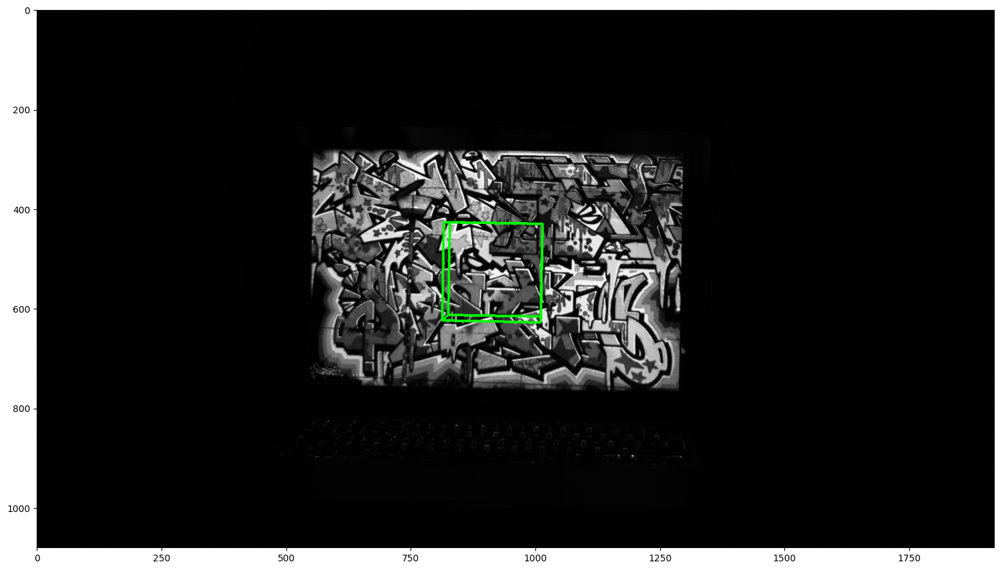

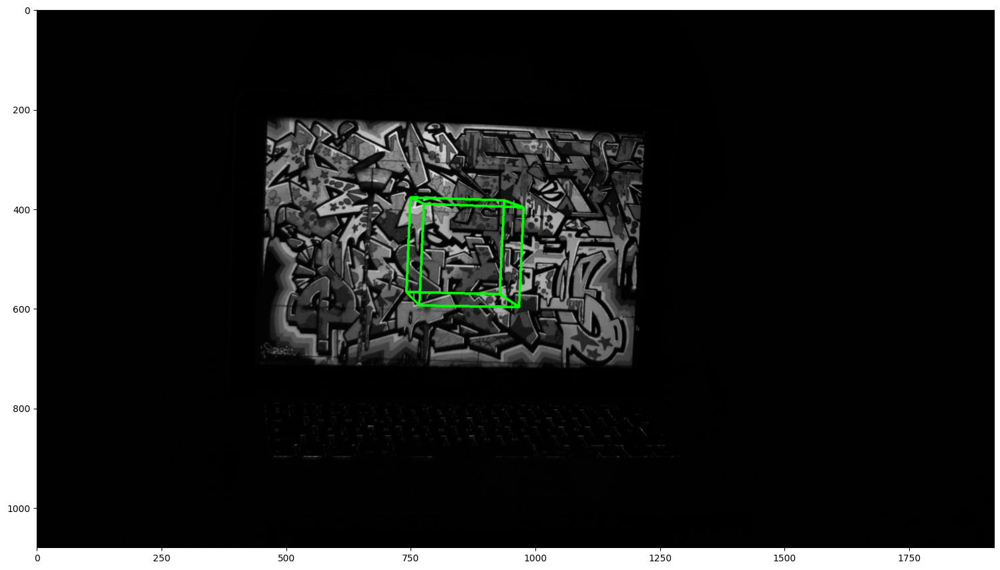

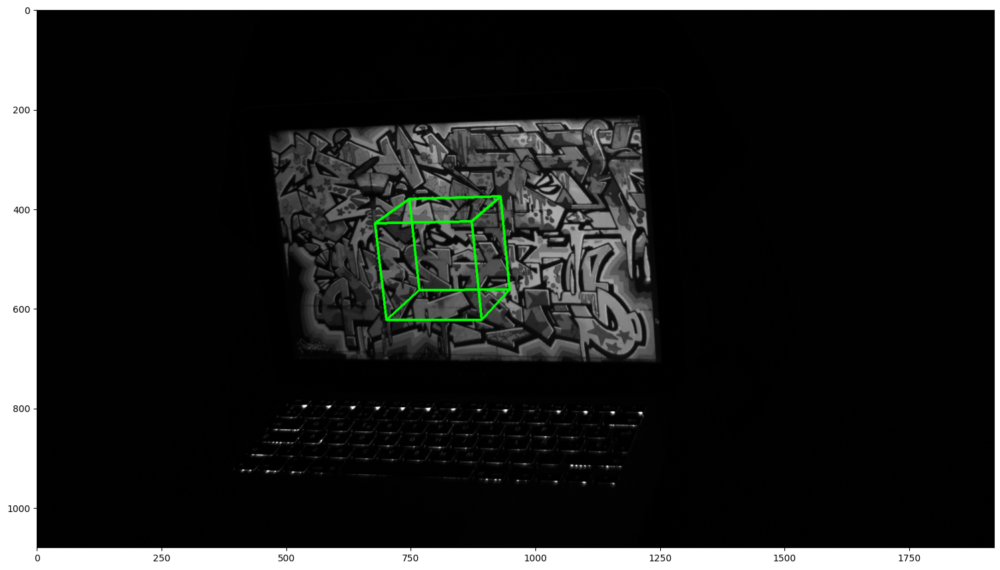

In [22]:
Th, Tw = template.shape
cube_corners = np.array([[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0], [0, 0, 0], [0, 0, 1], [1, 0, 1], [1, 1, 1], [0, 1, 1], [0, 0, 1], [0, 0, 0], [1, 0, 0], [1, 0, 1], [0, 0, 1], [0, 0, 0], [0, 1, 0], [1, 1, 0], [1, 1, 1], [0, 1, 1], [0, 1, 0]])

import numpy.matlib
offset = np.array([Tw/2, Th/2, -Tw/8])
M = cube_corners.shape[0]
X = (cube_corners - 0.5) * Tw/ 4 + np.matlib.repmat(offset, M, 1)

X = X.T
ones = np.ones(M)
Xh = np.stack((X[0,:], X[1,:], X[2,:], ones), axis=0)

line_color = (0, 255, 0)

for i in range(N):
    
    xp = P[i]@Xh
    xp = xp / xp[2,:]
    xp = xp.astype(int)
    
    image = cv2.imread("Data/calib/graffiti{0}.tif".format(i+1),cv2.IMREAD_COLOR)
    image_gray = image
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    image_gray[:, :, 0] = gray[:, :]
    image_gray[:, :, 1] = image_gray[:, :, 0]
    image_gray[:, :, 2] = image_gray[:, :, 0]
    for j in range(M-1):
        image = cv2.line(image_gray, (xp[0,j],xp[1,j]), (xp[0,j+1],xp[1,j+1]), line_color, 4) 
    plt.imshow(image)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()


## **5. OPTIONAL. Application: Logo detection**

<span style='color:Green'> - Detect the UPF logo in the two UPF images using the DLT algorithm (folder "logos").
Interpret and comment the results. </span>

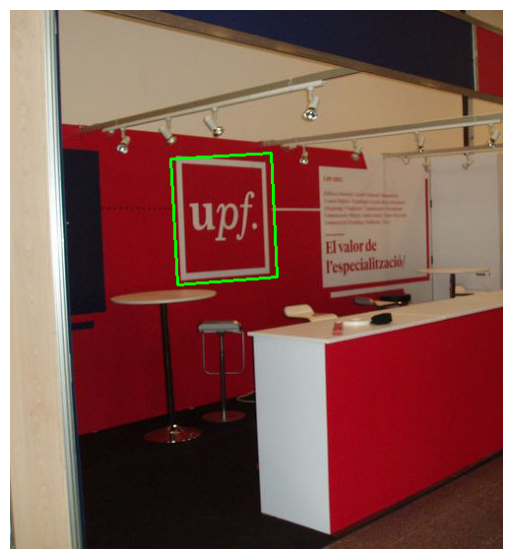

In [6]:
# Read images (grayscale for matching)
logo = cv2.imread("Data/logos/logoUPF.png", cv2.IMREAD_GRAYSCALE)
img  = cv2.imread("Data/logos/UPFstand.jpg",  cv2.IMREAD_GRAYSCALE)

# SIFT keypoints
sift = cv2.SIFT_create()
kpL, desL = sift.detectAndCompute(logo, None)
kpI, desI = sift.detectAndCompute(img, None)

# Matching + ratio-test
bf = cv2.BFMatcher()
matches = bf.knnMatch(desL, desI, k=2)

good_matches = []
for m, n in matches:
    if m.distance < 0.85*n.distance:
        good_matches.append([m])

# Build correspondences matrices
pointsL = []
pointsI = []
for m in good_matches:
    pointsL.append([kpL[m[0].queryIdx].pt[0], kpL[m[0].queryIdx].pt[1], 1])
    pointsI.append([kpI[m[0].trainIdx].pt[0], kpI[m[0].trainIdx].pt[1], 1])

ptsL = np.asarray(pointsL).T
ptsI = np.asarray(pointsI).T

# Estimate homography
H_stand, inliers = Ransac_DLT_homography(ptsL, ptsI, 2, 3000)
inlier_matches = itemgetter(*inliers)(good_matches)

# Project logo corners onto image and draw 
hL, wL = logo.shape[:2]
cornersL = np.array([[0, 0, 1],
                     [wL-1, 0, 1],
                     [wL-1, hL-1, 1],
                     [0, hL-1, 1]]).T


proj = H_stand @ cornersL
proj = proj / proj[2,:]
proj_xy = proj[:2,:].T.astype(np.int32)

img_color = cv2.imread("Data/logos/UPFstand.jpg")
img_color = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
cv2.polylines(img_color, [proj_xy], True, (0,255,0), 2)

plt.figure(figsize=(12,7))
plt.imshow(img_color)
plt.axis("off")
plt.show()

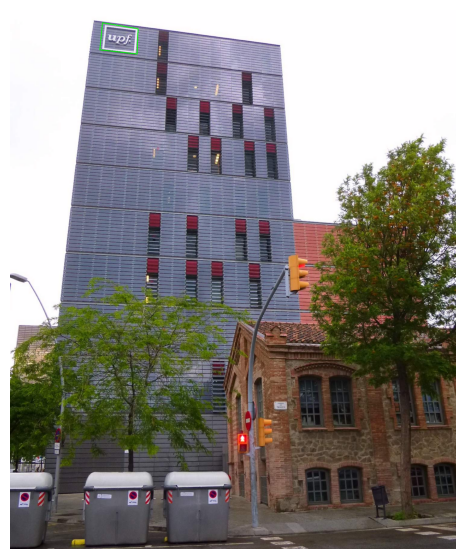

In [28]:
# Read images (grayscale for matching)
logo = cv2.imread("Data/logos/logoUPF.png", cv2.IMREAD_GRAYSCALE)
img  = cv2.imread("Data/logos/UPFbuilding.jpg",  cv2.IMREAD_GRAYSCALE)

# SIFT keypoints
sift = cv2.SIFT_create()
kpL, desL = sift.detectAndCompute(logo, None)
kpI, desI = sift.detectAndCompute(img, None)

# Matching + ratio-test
bf = cv2.BFMatcher()
matches = bf.knnMatch(desL, desI, k=2)

good_matches = []
for m, n in matches:
    if m.distance < 0.85*n.distance:
        good_matches.append([m])

# Build correspondences matrices
pointsL = []
pointsI = []
for m in good_matches:
    pointsL.append([kpL[m[0].queryIdx].pt[0], kpL[m[0].queryIdx].pt[1], 1])
    pointsI.append([kpI[m[0].trainIdx].pt[0], kpI[m[0].trainIdx].pt[1], 1])

ptsL = np.asarray(pointsL).T
ptsI = np.asarray(pointsI).T

# Estimate homography
H_building, inliers = Ransac_DLT_homography(ptsL, ptsI, 10, 3000)
inlier_matches = itemgetter(*inliers)(good_matches)

# Project logo corners onto image and draw 
hL, wL = logo.shape[:2]
cornersL = np.array([[0, 0, 1],
                     [wL-1, 0, 1],
                     [wL-1, hL-1, 1],
                     [0, hL-1, 1]]).T


proj = H_building @ cornersL
proj = proj / proj[2,:]
proj_xy = proj[:2,:].T.astype(np.int32)

img_color = cv2.imread("Data/logos/UPFbuilding.jpg")
img_color = cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB)
cv2.polylines(img_color, [proj_xy], True, (0,255,0), 2)

plt.figure(figsize=(12,7))
plt.imshow(img_color)
plt.axis("off")
plt.show()

## **6. OPTIONAL. Application: Logo replacement**

<span style='color:Green'> - Replace the UPF logo by the master logo in one of the previous images using the DLT algorithm. </span>


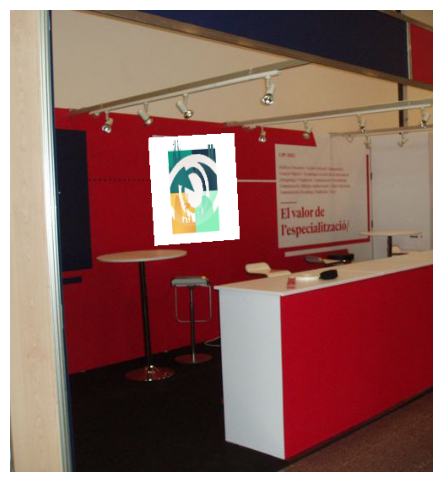

True

In [21]:
# Read color images
scene_bgr = cv2.imread("Data/logos/UPFstand.jpg")              
scene_rgb = cv2.cvtColor(scene_bgr, cv2.COLOR_BGR2RGB)

logo_template = cv2.imread("Data/logos/logoUPF.png")          
logo_master   = cv2.imread("Data/logos/logo_master.png")       

logo_master_rgb = cv2.cvtColor(logo_master, cv2.COLOR_BGR2RGB)

# Resize master to template size
# H maps template -> scene, so both must have the same dimensions
hT, wT = logo_template.shape[:2]
logo_master_rgb = cv2.resize(logo_master_rgb, (wT, hT), interpolation=cv2.INTER_LINEAR)

# Warp the master logo into the scene
H_scene, W_scene = scene_rgb.shape[:2]
corners_scene = [0, W_scene - 1, 0, H_scene - 1]

# apply_H_fixed_image_size performs inverse mapping + bilinear interpolation
warped_master = apply_H_fixed_image_size(
    logo_master_rgb.astype(np.float32),
    H_stand,
    corners_scene
)
warped_master = np.clip(warped_master, 0, 255).astype(np.uint8)

# Project template corners into the scene 
cornersT = np.array([[0, 0, 1],
                     [wT - 1, 0, 1],
                     [wT - 1, hT - 1, 1],
                     [0, hT - 1, 1]], dtype=np.float64).T  

proj = H_stand @ cornersT            
proj = proj / proj[2, :]      
proj_xy = proj[:2, :].T.astype(np.int32)

# Create a mask of the projected logo area
maskT = np.ones((hT, wT), dtype=np.float32) * 255.0
warped_mask = apply_H_fixed_image_size(maskT, H_stand, corners_scene)
mask_f = np.clip(warped_mask / 255.0, 0, 1)[:, :, None]  # (H,W,1)

# Blend: replace the original logo with the warped master logo
out = (scene_rgb.astype(np.float32) * (1 - mask_f) + warped_master.astype(np.float32) * mask_f).astype(np.uint8)

plt.figure(figsize=(10,6))
plt.imshow(out)
plt.axis("off")
plt.show()

cv2.imwrite("logo_replacement_stand.png", cv2.cvtColor(out, cv2.COLOR_RGB2BGR))


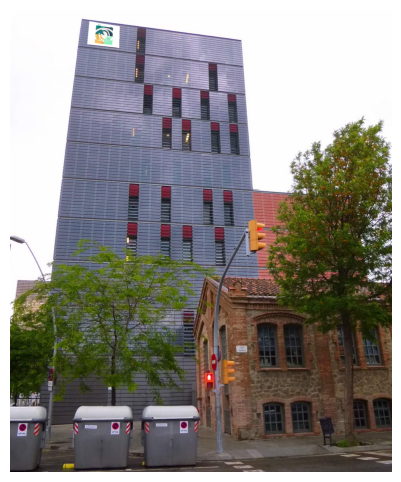

True

In [29]:
# Read color images
scene_bgr = cv2.imread("Data/logos/UPFbuilding.jpg")              
scene_rgb = cv2.cvtColor(scene_bgr, cv2.COLOR_BGR2RGB)

logo_template = cv2.imread("Data/logos/logoUPF.png")          
logo_master   = cv2.imread("Data/logos/logo_master.png")       

logo_master_rgb = cv2.cvtColor(logo_master, cv2.COLOR_BGR2RGB)

# Resize master to template size
# H maps template -> scene, so both must have the same dimensions
hT, wT = logo_template.shape[:2]
logo_master_rgb = cv2.resize(logo_master_rgb, (wT, hT), interpolation=cv2.INTER_LINEAR)

# Warp the master logo into the scene
H_scene, W_scene = scene_rgb.shape[:2]
corners_scene = [0, W_scene - 1, 0, H_scene - 1]

# apply_H_fixed_image_size performs inverse mapping + bilinear interpolation
warped_master = apply_H_fixed_image_size(
    logo_master_rgb.astype(np.float32),
    H_building,
    corners_scene
)
warped_master = np.clip(warped_master, 0, 255).astype(np.uint8)

# Project template corners into the scene 
cornersT = np.array([[0, 0, 1],
                     [wT - 1, 0, 1],
                     [wT - 1, hT - 1, 1],
                     [0, hT - 1, 1]], dtype=np.float64).T  

proj = H_building @ cornersT            
proj = proj / proj[2, :]      
proj_xy = proj[:2, :].T.astype(np.int32)

# Create a mask of the projected logo area
maskT = np.ones((hT, wT), dtype=np.float32) * 255.0
warped_mask = apply_H_fixed_image_size(maskT, H_building, corners_scene)
mask_f = np.clip(warped_mask / 255.0, 0, 1)[:, :, None]  # (H,W,1)

# Blend: replace the original logo with the warped master logo
out = (scene_rgb.astype(np.float32) * (1 - mask_f) + warped_master.astype(np.float32) * mask_f).astype(np.uint8)

plt.figure(figsize=(10,6))
plt.imshow(out)
plt.axis("off")
plt.show()

cv2.imwrite("logo_replacement_building.png", cv2.cvtColor(out, cv2.COLOR_RGB2BGR))